# **Лабораторная работа**
*Naumov Anton (Any0019)*

*To contact me in telegram: @any0019*

В данном задании вашей задачей будет построить и обучить модель CycleGAN для задачи Img2Img.

---

Про задачу __Img2Img__:

- У вас есть 2 множества изображений ($A$ и $B$)
- Ваша задача - научиться превращать изображения из множества $A$ в изображения из множества $B$ и наоборот
- Бывают paired и unpaired множества
- В случае __paired__ множеств - для каждого изображения из $A$ существует конкретное изображение из $B$, в которое оно должно перейти (и наоборот). Примером такой пары множеств может быть (а) спутниковая фотграфия местности vs схематическая карта местности , (б) фотография фасада здания vs схема фасада здания , ...
- В случае __unpaired__ множеств - между множествами нет конкретных пар. Примером такой пары множеств может быть (а) фотографии с лошадьми vs фотографии с зебрами , (б) фотографии vs рисунки конкретного художника , ...

---

Про модель __CycleGAN__:

- Модель придумана для задачи Img2Img (в первую очередь unpaired версии) и основана на концепции GAN-ов
- В модели есть 2 генератора: $G_{A -> B}$ (задача которого - принимая на вход изображение из множества $A$ переводить его в изображение из множества $B$) и $G_{B -> A}$ (аналогично в другую сторону)
- Надо отметить что на вход генераторы не получают никакую дополнительную случайность, что делает обучение таких моделей проще
- В модели так же есть 2 дискриминатора: $D_{A}$ (задача которого - отличать реальные изображения из $A$ от сгенерированных с помощью $G_{B -> A}$ изображений) и $D_{B}$ (аналогично для $B$)
- Функцией ошибки будет, как и для GAN-ов, minmax игра между генераторами и дискриминаторами, но к ошибке генераторов добавится ещё и, так называемый, `cycle consistency loss`, который проверяет, что после двойного перехода изображения не меняются $G_{B -> A} \big( G_{A -> B} ( a ) \big) = a ; \forall a \in A$ и $G_{A -> B} \big( G_{B -> A} ( b ) \big) = b ; \forall b \in B$
- Так же можно добавлять или нет штраф за то, чтобы $G_{B -> A}$ не меняла изображения из $A$ и наоборот $G_{A -> B}$ не меняла изображения из $B$
- Оригинальная статья: https://arxiv.org/pdf/1703.10593.pdf

---

Ваша задача - ноутбук разбит на несколько частей, каждая со своими баллами

1. __Подготовка данных__ _(2 балла)_ --> требуется выбрать датасет для обучения (дано несколько на выбор) и составить пайплайн подготовки данных
2. __Составление модели__ _(6 баллов)_ --> требуется собрать нейросеть _(3 балла)_ и создать функции ошибки _(3 балла)_
3. __Подготовка обучения__ _(2 балла)_ --> требуется написать шаги обучения и валидации, визуализацию, а так же полный цикл обучения
4. __Обучение__ _(2 балла)_ --> требуется обучить модель
5. __Сбор своего датасета и обучение модели на нём__ _(3 балла)_ --> требуется собрать свой датасет и обучить на нём модель

***За наиболее интересные и качественные решения в пункте 5 так же предусмотрены дополнительные баллы***

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import Dataset, DataLoader

from torchvision import datasets, transforms as tr

import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

# Для тёмной темы jupyter - уберите если не нужно
plt.style.use('dark_background')

from tqdm.auto import tqdm, trange

import os
import sys
import requests
import cv2

from dataclasses import dataclass

import os
import matplotlib.pyplot as plt
from torchvision import datasets

from torchvision import transforms
from PIL import Image

# 1. Подготовка данных (___2 балла___)

In [2]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)

cuda


## 1.1 Выбор и скачивание датасета

In [5]:
dataset_folder = "/home/jupyter/datasphere/project/datasets/img2img"
dataset_folder = "/content/$/home/jupyter/datasphere/project/datasets/img2img"
num_images_per_split = 5

os.environ["dataset_folder"] = dataset_folder
!mkdir -p ${dataset_folder}

# В этом цикле каждый из предложенных датасетов
#  - скачивается
#  - распаковывается
#  - отрисовывается + meta
#  - удаляется

# Предлагается посмотреть на все предложенные варианты датасетов и затем оставить один,
#  с которым захочется работать больше всего - закомментируйте (или удалите) все, кроме
#  выбранного, а так же закомментируйте строчки с удалением скачанного датасета
for dataset_name in [
    #"monet2photo",
    #"apple2orange",
    "horse2zebra",
]:
    print(f"Dataset '{dataset_name}'")
    url = f"http://efrosgans.eecs.berkeley.edu/cyclegan/datasets/{dataset_name}.zip"
    download_path = os.path.join(dataset_folder, f"{dataset_name}.zip")
    target_folder = os.path.join(dataset_folder, dataset_name)

    # Чтобы bash вызовы знали соответствующие переменные
    os.environ["url"] = url
    os.environ["download_path"] = download_path
    os.environ["target_folder"] = target_folder

    print("Loading zip file...", end="")
    # Проверяем что нет такого загруженого файла
    if not os.path.isfile(download_path) or os.path.exists(target_folder):
        # # Можно загрузить через requests библиотеку
        # response = requests.get(url)
        # open(download_path, "wb").write(response.content)

        # Можно загрузить через wget
        !wget ${url} -O ${download_path}
    print(" --> done!")

    print("Unziping...", end="")
    # Распаковываем
    if os.path.exists(target_folder):
        !rm -r ${target_folder}
    !mkdir -p ${dataset_folder}
    !unzip -qq ${download_path} -d ${dataset_folder}
    print(" --> done!")

    # Удаляем zip-файл
    !rm ${download_path}

    # Meta + Отрисовка
    print(f"Provided splits: {os.listdir(target_folder)}")
    # Удобный способ быстро получить датасет картинок с лэйблами, если картинки разложены по папкам в формате:
    # root_folder/label_name/img.jpg
    # (в нашем случае нет лэйблов, но картинки разложены в таком же формате, просто вместо label_name идёт
    #  split_name: trainA/testA/trainB/testB)
    dataset = datasets.ImageFolder(target_folder)

    inds_to_show = {i: [] for i, _ in enumerate(dataset.classes)}
    classes_full = 0
    for dataset_ind in range(len(dataset)):
        _, split_ind = dataset[dataset_ind]
        if len(inds_to_show[split_ind]) == num_images_per_split:
            continue
        inds_to_show[split_ind].append(dataset_ind)
        if len(inds_to_show[split_ind]) == num_images_per_split:
            classes_full += 1
        if classes_full == len(dataset.classes):
            break

    for split_name in sorted(dataset.classes):
        split_ind = dataset.class_to_idx[split_name]
        print(f"Split '{split_name}' of dataset '{dataset_name}'", end="")
        split_folder = os.path.join(target_folder, split_name)
        print(f" --> size: {len(os.listdir(split_folder))}")

        plt.subplots(1, num_images_per_split, figsize=(5 * num_images_per_split, 5))
        plt.suptitle(f"{dataset_name} ~ {split_name}", y=0.95)
        for i, dataset_ind in enumerate(inds_to_show[split_ind]):
            plt.subplot(1, num_images_per_split, i + 1)
            plt.imshow(dataset[dataset_ind][0])
            plt.xticks([])
            plt.yticks([])
        plt.show()

    # Удаляем скачанный датасет
    !rm -r ${target_folder}

    print("\n----------------------------\n")

Dataset 'horse2zebra'
Loading zip file...://efrosgans.eecs.berkeley.edu/cyclegan/datasets/horse2zebra.zip: Scheme missing.
 --> done!
Unziping...[$/content/$/home/jupyter/datasphere/project/datasets/img2img/horse2zebra.zip]
  End-of-central-directory signature not found.  Either this file is not
  a zipfile, or it constitutes one disk of a multi-part archive.  In the
  latter case the central directory and zipfile comment will be found on
  the last disk(s) of this archive.
unzip:  cannot find zipfile directory in one of $/content/$/home/jupyter/datasphere/project/datasets/img2img/horse2zebra.zip or
        $/content/$/home/jupyter/datasphere/project/datasets/img2img/horse2zebra.zip.zip, and cannot find $/content/$/home/jupyter/datasphere/project/datasets/img2img/horse2zebra.zip.ZIP, period.
 --> done!


FileNotFoundError: [Errno 2] No such file or directory: '/content/$/home/jupyter/datasphere/project/datasets/img2img/horse2zebra'

Loading zip file...--2025-04-11 04:38:13--  http://efrosgans.eecs.berkeley.edu/cyclegan/datasets/horse2zebra.zip
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 116867962 (111M) [application/zip]
Saving to: ‘/content/$/home/jupyter/datasphere/project/datasets/img2img/horse2zebra.zip’

/content/$/home/jup 100%[===================>] 111.45M  2.56MB/s    in 29s     

2025-04-11 04:38:43 (3.82 MB/s) - ‘/content/$/home/jupyter/datasphere/project/datasets/img2img/horse2zebra.zip’ saved [116867962/116867962]

 --> done!
Unzipping... --> done!
Provided splits: ['trainA', 'testA', 'trainB', 'testB']
Split 'testA' of dataset 'horse2zebra' --> size: 120


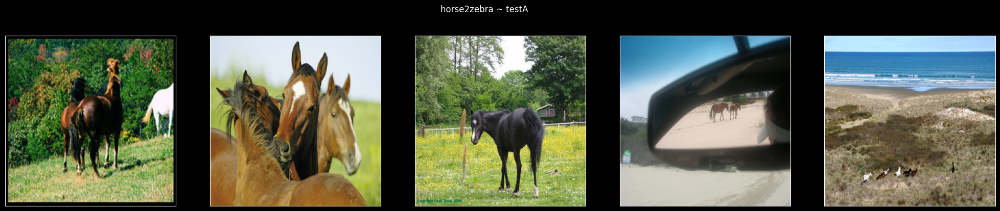

Split 'testB' of dataset 'horse2zebra' --> size: 140


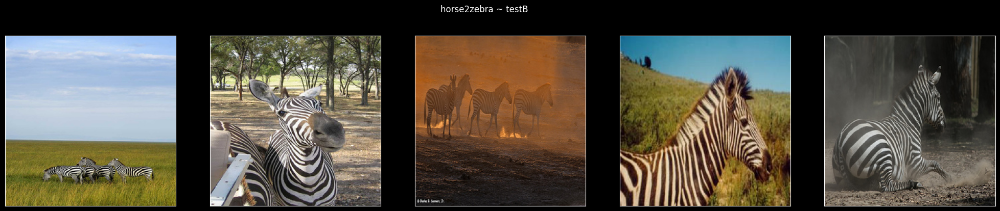

Split 'trainA' of dataset 'horse2zebra' --> size: 1067


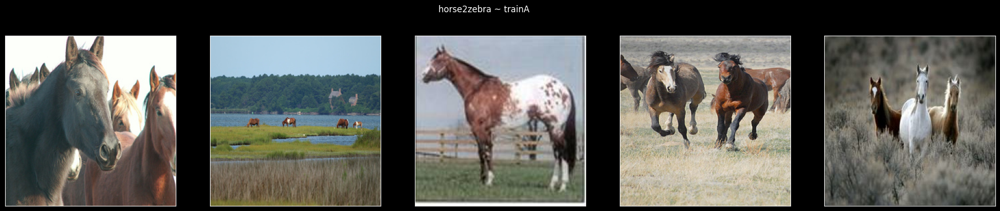

Split 'trainB' of dataset 'horse2zebra' --> size: 1334


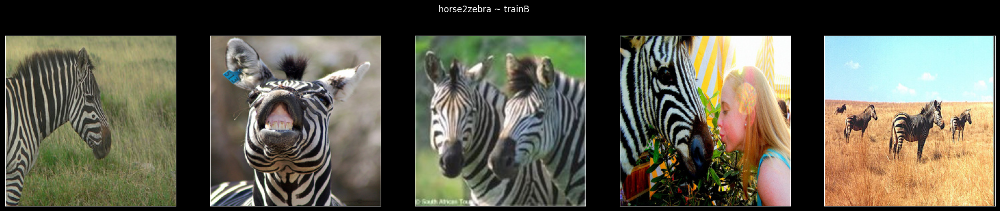


----------------------------



In [6]:
print("Loading zip file...", end="")
if not os.path.isfile(download_path) or os.path.exists(target_folder):
    !wget {url} -O {download_path}
print(" --> done!")

print("Unzipping...", end="")
if os.path.exists(target_folder):
    !rm -r {target_folder}
os.makedirs(dataset_folder, exist_ok=True)
!unzip -qq {download_path} -d {dataset_folder}
print(" --> done!")

# !rm {download_path}  # Закомментируй, если не хочешь удалять zip

print(f"Provided splits: {os.listdir(target_folder)}")
dataset = datasets.ImageFolder(target_folder)

inds_to_show = {i: [] for i, _ in enumerate(dataset.classes)}
classes_full = 0
for dataset_ind in range(len(dataset)):
    _, split_ind = dataset[dataset_ind]
    if len(inds_to_show[split_ind]) == num_images_per_split:
        continue
    inds_to_show[split_ind].append(dataset_ind)
    if len(inds_to_show[split_ind]) == num_images_per_split:
        classes_full += 1
    if classes_full == len(dataset.classes):
        break

for split_name in sorted(dataset.classes):
    split_ind = dataset.class_to_idx[split_name]
    print(f"Split '{split_name}' of dataset '{dataset_name}'", end="")
    split_folder = os.path.join(target_folder, split_name)
    print(f" --> size: {len(os.listdir(split_folder))}")

    plt.subplots(1, num_images_per_split, figsize=(5 * num_images_per_split, 5))
    plt.suptitle(f"{dataset_name} ~ {split_name}", y=0.95)
    for i, dataset_ind in enumerate(inds_to_show[split_ind]):
        plt.subplot(1, num_images_per_split, i + 1)
        plt.imshow(dataset[dataset_ind][0])
        plt.xticks([])
        plt.yticks([])
    plt.show()

# !rm -r {target_folder}  # Закомментируй, если не хочешь удалять
print("\n----------------------------\n")

## 1.2 Dataset и Transforms

В папке `target_folder` находятся несколько папок со сплитами для соответствующего датасета, в каждой папке сплита находятся сами `.jpg` изображения.

Давайте составим их в удобном для нас виде в отдельные датасеты для каждого сплита без лэйблов.

Для получения картинок можно использовать
```python
cv2.imread(img_path)[:, :, ::-1]  # каналы записаны в обратном порядке
```

In [8]:
# Выбранный выше и скачанный датасет
dataset_folder = "/home/jupyter/datasphere/project/datasets/img2img"
dataset_name = "horse2zebra"
target_folder = "/content/$/home/jupyter/datasphere/project/datasets/img2img/horse2zebra"

# Класс для датасета изображений без лэйблов с применением трансформов
class ImageDatasetNoLabel(Dataset):
    def __init__(self, folder_path, transform=None):
        super().__init__()
        self.folder_path = folder_path
        self.image_paths = sorted([
            os.path.join(folder_path, fname)
            for fname in os.listdir(folder_path)
            if fname.lower().endswith(('.png', '.jpg', '.jpeg'))
        ])
        self.transform = transform

    def __getitem__(self, index):
        img_path = self.image_paths[index]
        image = Image.open(img_path).convert("RGB")
        if self.transform: image = self.transform(image)
        return image

    def __len__(self):
        return len(self.image_paths)

# Удобный класс для хранения всех наших датасетов
@dataclass
class DatasetsClass:
    train_a: ImageDatasetNoLabel
    train_b: ImageDatasetNoLabel
    test_a: ImageDatasetNoLabel
    test_b: ImageDatasetNoLabel


# Все датасеты без трансформов - чтобы посчитать статистики
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(os.path.join(target_folder, "trainA"), transform=transforms.ToTensor()),
    train_b=ImageDatasetNoLabel(os.path.join(target_folder, "trainB"), transform=transforms.ToTensor()),
    test_a=ImageDatasetNoLabel(os.path.join(target_folder, "testA"), transform=transforms.ToTensor()),
    test_b=ImageDatasetNoLabel(os.path.join(target_folder, "testB"), transform=transforms.ToTensor()),
)

In [9]:
def get_channel_statistics(dataset):
    """
    Функция для получения поканальных статистик (среднее и отклонение) по датасету
    """
    loader = DataLoader(dataset, batch_size=1, shuffle=False, num_workers=2)
    n_images = 0
    channel_mean = torch.zeros(3)
    channel_std = torch.zeros(3)

    for batch in loader:
        b, c, h, w = batch.shape
        channel_mean += batch.sum(dim=[0, 2, 3])
        channel_std += (batch ** 2).sum(dim=[0, 2, 3])
        n_images += b

    total_pixels = n_images * h * w
    channel_mean /= total_pixels
    channel_std = (channel_std / total_pixels - channel_mean ** 2).sqrt()
    return channel_mean, channel_std

# Поканальное среднее и отклонение для A
channel_mean_a, channel_std_a = get_channel_statistics(ds.train_a)
print(channel_mean_a, channel_std_a)

# Поканальное среднее и отклонение для B
channel_mean_b, channel_std_b = get_channel_statistics(ds.train_b)
print(channel_mean_b, channel_std_b)

tensor([0.5266, 0.5188, 0.4580]) tensor([0.2366, 0.2380, 0.2645])
tensor([0.4831, 0.4673, 0.3972]) tensor([0.2643, 0.2541, 0.2532])


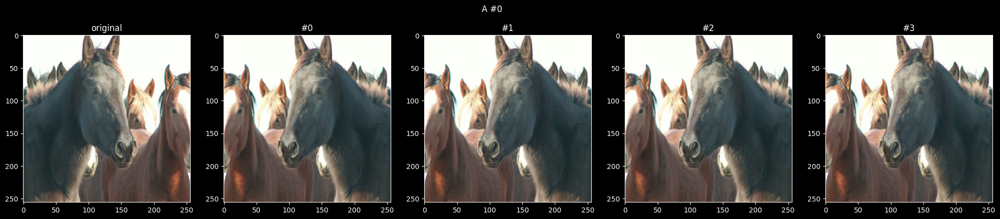

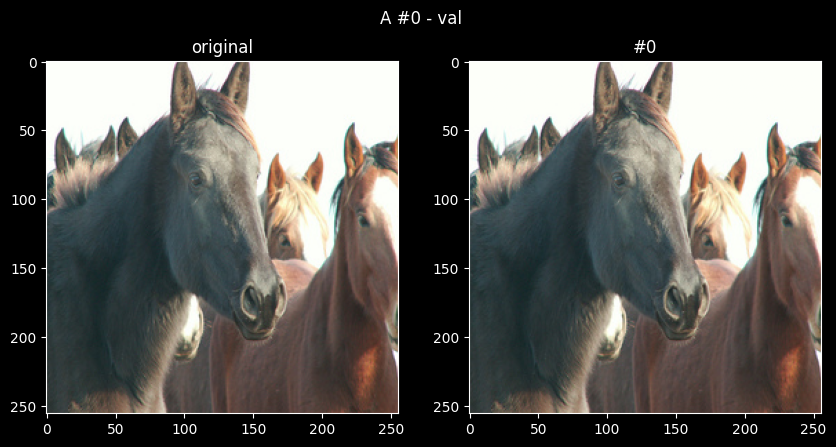

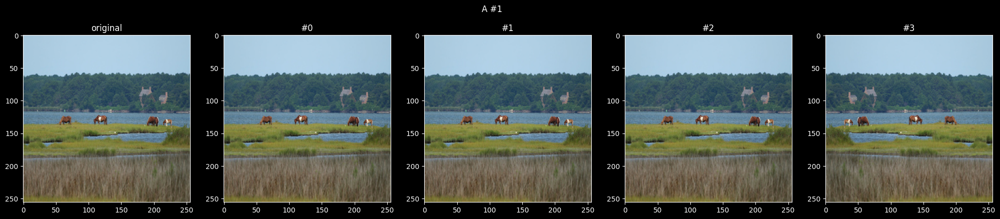

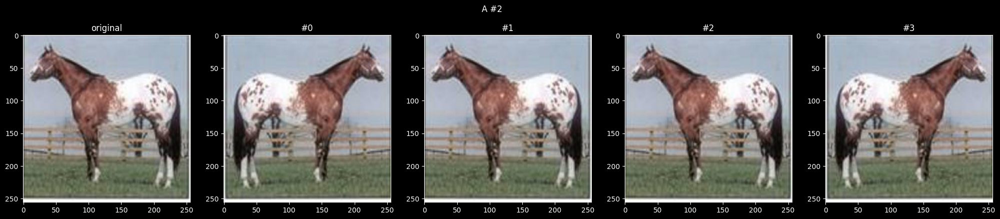

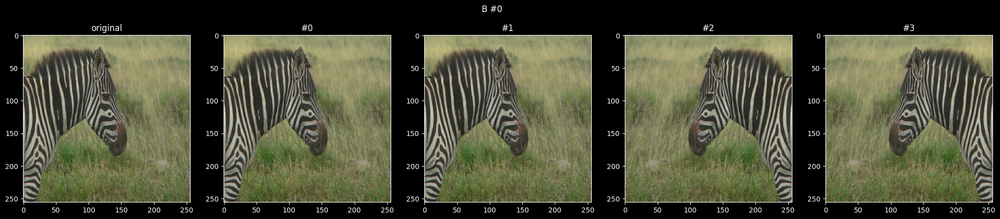

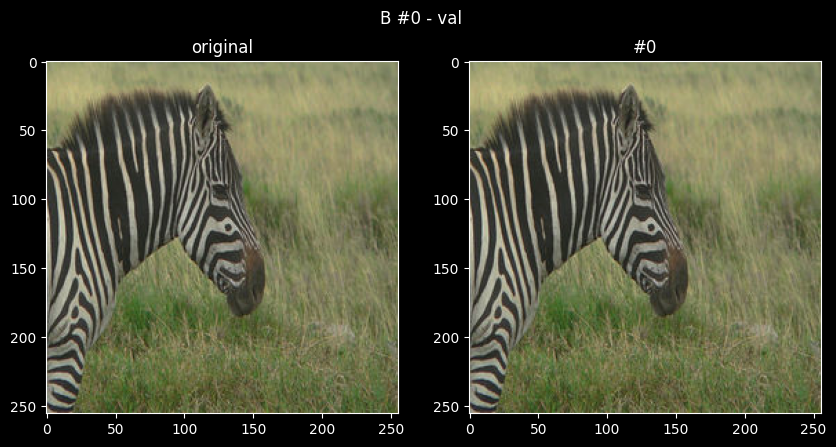

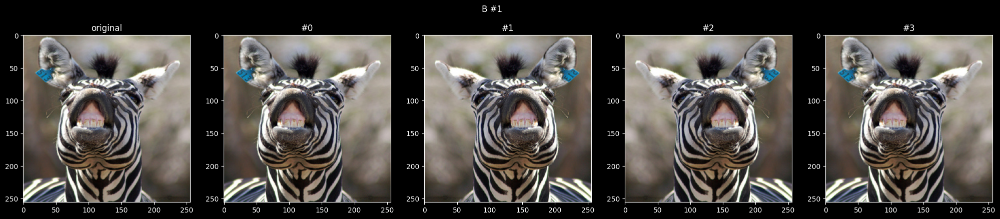

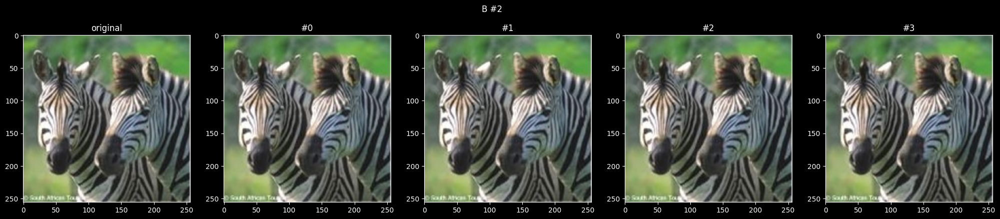

In [14]:
# Функция для получения train и val transform-ов, а так же функции для де-нормализации изображения
def get_transforms(mean, std, image_size=256, jitter_params=None, sharpness=2):
    train_transform = tr.Compose([
            #tr.Resize(int(image_size * 1.12)),
            #tr.RandomCrop(image_size),
            tr.RandomHorizontalFlip(p=0.5),
            #tr.ColorJitter(**jitter_params),
            #tr.RandomAutocontrast(p=0.1),
            #tr.RandomEqualize(p=0.1),
            #tr.RandomAdjustSharpness(sharpness_factor=sharpness, p=0.2),
            tr.ToTensor(),
            tr.Normalize(mean, std),
        ])

    val_transform = tr.Compose([
        tr.Resize((image_size, image_size)),
        tr.ToTensor(),
        tr.Normalize(mean, std)
    ])

    def de_normalize(tensor):
        tensor = tensor.clone()
        for t, m, s in zip(tensor, mean, std):
            t.mul_(s).add_(m)
        return tensor.permute(1, 2, 0).cpu().numpy()

    return train_transform, val_transform, de_normalize


# Ваши гиперпараметры
hyperparams = dict(
    image_size=256,
    jitter_params=dict(brightness=0.2, contrast=0.1, saturation=0.2, hue=0.05),
    sharpness=2.0
)
# transform-ы для A и B
train_transform_a, val_transform_a, de_normalize_a = get_transforms(channel_mean_a, channel_std_a, **hyperparams)
train_transform_b, val_transform_b, de_normalize_b = get_transforms(channel_mean_b, channel_std_b, **hyperparams)


# Функция для визуализации transform-ов
def show_examples(dataset, transform, de_norm, num_per_image=3, image_index=0, title=""):
    fig, ax = plt.subplots(1, 1 + num_per_image, figsize=(5 * (1 + num_per_image), 5))

    image = dataset[image_index]

    plt.suptitle(title, y=0.95)

    plt.subplot(1, 1 + num_per_image, 1)
    plt.imshow(image)
    plt.title("original")

    for i in range(num_per_image):
        plt.subplot(1, 1 + num_per_image, i + 2)
        plt.title(f"#{i}")
        plt.imshow(de_norm(transform(image)))
    plt.show()

# Проверка на адекватность
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=0, title="A #0")
show_examples(ds.train_a, val_transform_a, de_normalize_a, num_per_image=1, image_index=0, title="A #0 - val")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=1, title="A #1")
show_examples(ds.train_a, train_transform_a, de_normalize_a, num_per_image=4, image_index=2, title="A #2")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=0, title="B #0")
show_examples(ds.train_b, val_transform_b, de_normalize_b, num_per_image=1, image_index=0, title="B #0 - val")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=1, title="B #1")
show_examples(ds.train_b, train_transform_b, de_normalize_b, num_per_image=4, image_index=2, title="B #2")

In [16]:
# Все датасеты с трансформами
ds = DatasetsClass(
    train_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainA"),
        transform=train_transform_a,
    ),
    train_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "trainB"),
        transform=val_transform_b,
    ),
    test_a=ImageDatasetNoLabel(
        os.path.join(target_folder, "testA"),
        transform=val_transform_a,
    ),
    test_b=ImageDatasetNoLabel(
        os.path.join(target_folder, "testB"),
        transform=val_transform_b,
    ),
)

## 1.3 DataLoader

In [18]:
@dataclass
class DataLoadersClass:
    train_a: DataLoader
    train_b: DataLoader
    test_a: DataLoader
    test_b: DataLoader

train_batch_size = 1
val_batch_size = 8

dataloaders = DataLoadersClass(
    train_a=DataLoader(
        dataset=ds.train_a,
        batch_size=train_batch_size,
        shuffle=True,
        drop_last=True,
    ),
    train_b=DataLoader(
        dataset=ds.train_b,
        batch_size=train_batch_size,
        shuffle=True,
        drop_last=True,
    ),
    test_a=DataLoader(
        dataset=ds.test_a,
        batch_size=val_batch_size,
        shuffle=False,
        drop_last=True,
    ),
    test_b=DataLoader(
        dataset=ds.test_b,
        batch_size=val_batch_size,
        shuffle=False,
        drop_last=True,
    ),
)

# 2. Модель (___6 баллов___)

## 2.0 Любые вспомогательные модули и классы

In [52]:
import torch.nn as nn

class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super(ResnetBlock, self).__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3),
            nn.InstanceNorm2d(dim),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3),
            nn.InstanceNorm2d(dim)
        )

    def forward(self, x):
        return x + self.block(x)


class Generator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, n_res_blocks=6, ngf=32):
        super(Generator, self).__init__()

        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(in_channels, ngf, kernel_size=7),
            nn.InstanceNorm2d(ngf),
            nn.ReLU(True),
        ]

        in_features = ngf
        out_features = in_features * 2

        model += [
            nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(True),
        ]

        in_features = out_features
        out_features = in_features * 2

        model += [
            nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(True),
        ]
        in_features = out_features
        out_features = in_features * 2

        for _ in range(n_res_blocks):
            model += [ResnetBlock(in_features)]

        out_features = in_features // 2

        model += [
            nn.ConvTranspose2d(in_features, out_features, 3, stride=2, padding=1, output_padding=1),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(True),
        ]
        in_features = out_features
        out_features = in_features // 2

        model += [
            nn.ConvTranspose2d(in_features, out_features, 3, stride=2, padding=1, output_padding=1),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(True),
        ]
        in_features = out_features
        out_features = in_features // 2

        model += [
            nn.ReflectionPad2d(3),
            nn.Conv2d(ngf, out_channels, kernel_size=7),
            nn.Tanh()
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)



class Discriminator(nn.Module):
    def __init__(self, in_channels=3, ndf=64):
        super(Discriminator, self).__init__()

        model = [   nn.Conv2d(in_channels, ndf, 4, stride=2, padding=1),
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [  nn.Conv2d(ndf, 2 * ndf, 4, stride=2, padding=1),
                    nn.InstanceNorm2d(2 * ndf),
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [  nn.Conv2d(2 * ndf, 4 * ndf, 4, stride=2, padding=1),
                    nn.InstanceNorm2d(4 * ndf),
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [  nn.Conv2d(4 * ndf, 8 * ndf, 4, padding=1),
                    nn.InstanceNorm2d(8 * ndf),
                    nn.LeakyReLU(0.2, inplace=True) ]

        model += [nn.Conv2d(8 * ndf, 1, 4, padding=1)]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        x =  self.model(x)
        return F.avg_pool2d(x, x.size()[2:]).view(x.size()[0], -1)


## 2.1 Архитектура сети (___3 балла___)

In [20]:
class CycleGAN(nn.Module):
    def __init__(self, generator_ab, generator_ba, discriminator_a, discriminator_b):
        super(CycleGAN, self).__init__()
        self.G_AB = generator_ab
        self.G_BA = generator_ba
        self.D_A = discriminator_a
        self.D_B = discriminator_b

    def forward(self, real_a, real_b):
        fake_b = self.G_AB(real_a)
        fake_a = self.G_BA(real_b)

        rec_a = self.G_BA(fake_b)
        rec_b = self.G_AB(fake_a)

        return fake_a, fake_b, rec_a, rec_b

## 2.2 Loss (___3 балла___)

$$ \mathbf{L}_{\text{cyc}} \big( G_{A \rightarrow B}, G_{B \rightarrow A} \big) = \mathbb{E}_{a \sim A} \bigg( \Big\| G_{B \rightarrow A} \big( G_{A \rightarrow B} ( a ) \big) - a \Big\|_1 \bigg) + \mathbb{E}_{b \sim B} \bigg( \Big\| G_{A \rightarrow B} \big( G_{B \rightarrow A} ( b ) \big) - b \Big\|_1 \bigg) \longrightarrow \min_{G}$$

In [21]:
class CycleConsistencyLoss(nn.Module):
    """
    Функция ошибки, проверяющая что после двойного перехода через генераторы изображение не изменилось
    """
    def __init__(self):
        super(CycleConsistencyLoss, self).__init__()
        self.loss_fn = nn.L1Loss()

    def forward(self, x, x_rec):
        # Принимает на вход оригинальное изображение и изображение после двойного перехода
        return self.loss_fn(x_rec, x)

$$ \mathbf{L}_{\text{GAN}} \big( G_{A \rightarrow B}, D_{B} \big) = \mathbb{E}_{b \sim B} \log D_{B} (b) + \mathbb{E}_{a \sim A} \log \Big( 1 - D_{B} \big( G_{A \rightarrow B} (a) \big) \Big) \longrightarrow \min_{G} \max_{D}$$

In [22]:
class AdversarialLossCE(nn.Module):
    """
    Стандартная функция ошибки для minmax игры GAN-ов
    """
    def __init__(self):
        super(AdversarialLossCE, self).__init__()
        self.loss = nn.BCELoss()

    def forward(self, real_pred, fake_pred=None):
        # Принимает на вход D_{A}(a) - real_pred и D_{A}(G(b)) - fake_pred или наоборот
        # Может принимать только один аргумент для удобности использования в случае
        #  обучения или генератора, или дискриминатора
        if fake_pred is None:
            target_real = torch.ones_like(real_pred, dtype=real_pred.dtype, device=real_pred.device)
            return self.loss(real_pred, target_real)

        target_real = torch.ones_like(real_pred, dtype=real_pred.dtype, device=real_pred.device)
        target_fake = torch.zeros_like(fake_pred, dtype=fake_pred.dtype, device=fake_pred.device)

        loss_real = self.loss(real_pred, target_real)
        loss_fake = self.loss(fake_pred, target_fake)

        return 0.5 * (loss_real + loss_fake)

$$ \mathbb{E}_{b \sim B} \big( D_{B} (b) - 1 \big)^2 + \mathbb{E}_{a \sim A} \Big( D_{B} \big( G_{A \rightarrow B} (a) \big) \Big)^2 \longrightarrow \min_{D} $$
$$ \mathbb{E}_{a \sim A} \Big( D_{B} \big( G_{A \rightarrow B} (a) \big) - 1 \Big)^2 \longrightarrow \min_{G} $$

In [23]:
class AdversarialLossMSE(nn.Module):
    """
    Можно переписать не через CE, а через MSE loss на одном предсказании, помогает со стабильностью
    """
    def __init__(self):
        super(AdversarialLossMSE, self).__init__()
        self.loss = nn.MSELoss()

    def forward(self, real_pred, fake_pred=None):
        # Принимает на вход D_{A}(a) - real_pred и D_{A}(G(b)) - fake_pred или наоборот
        # Может принимать только один аргумент для удобности использования в случае
        #  обучения или генератора, или дискриминатора
        if fake_pred is None:
            target_real = torch.ones_like(real_pred, dtype=real_pred.dtype, device=real_pred.device)
            return self.loss(real_pred, target_real)

        target_real = torch.ones_like(real_pred, dtype=real_pred.dtype, device=real_pred.device)
        target_fake = torch.zeros_like(fake_pred, dtype=fake_pred.dtype, device=fake_pred.device)

        loss_real = self.loss(real_pred, target_real)
        loss_fake = self.loss(fake_pred, target_fake)

        return 0.5 * (loss_real + loss_fake)


$$ \mathbf{L} \big( G_{A \rightarrow B}, G_{B \rightarrow A}, D_{A}, D_{B} \big) = \mathbf{L}_{\text{GAN}} \big( G_{A \rightarrow B}, D_{B} \big) + \mathbf{L}_{\text{GAN}} \big( G_{B \rightarrow A}, D_{A} \big) + \lambda \cdot \mathbf{L}_{\text{cyc}} \big( G_{A \rightarrow B}, G_{B \rightarrow A} \big) \longrightarrow \min_{G} \max_{D}$$

In [37]:
class FullDiscriminatorLoss(nn.Module):
    """
    Полная ошибка для дискриминатора
    """
    def __init__(self, is_mse=True):
        super(FullDiscriminatorLoss, self).__init__()
        self.adversarial_loss_func = AdversarialLossMSE() if is_mse else AdversarialLossCE()

    def forward(
        self,
        a_real_pred,
        a_fake_pred,
        b_real_pred,
        b_fake_pred
    ):
        loss_d_a = self.adversarial_loss_func(a_real_pred, a_fake_pred)
        loss_d_b = self.adversarial_loss_func(b_real_pred, b_fake_pred)
        return loss_d_a + loss_d_b

In [25]:
class FullGeneratorLoss(nn.Module):
    """
    Полная ошибка для генератора
    """
    def __init__(self, lambda_cycle=10., lambda_identity=0.5, is_mse=True):
        super(FullGeneratorLoss, self).__init__()
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

        self.criterion_cycle = torch.nn.L1Loss()
        self.criterion_identity = torch.nn.L1Loss()
        self.adversarial_loss_func = AdversarialLossMSE() if is_mse else AdversarialLossCE() # criterion_GAN который, должен с коэф 1 идти

    def forward(
        self,
        a_fake_pred,
        b_fake_pred,
        imgs_a,
        rec_a,
        imgs_b,
        rec_b,
        same_a,
        same_b
    ):
        loss_cycle_aba = self.criterion_cycle(rec_a, imgs_a)
        loss_cycle_bab = self.criterion_cycle(rec_b, imgs_b)

        loss_identity_a = self.criterion_identity(same_a, imgs_a)
        loss_identity_b = self.criterion_identity(same_b, imgs_b)

        loss_g_a = self.adversarial_loss_func(a_fake_pred)
        loss_g_b = self.adversarial_loss_func(b_fake_pred)

        return self.lambda_cycle * (loss_cycle_aba + loss_cycle_bab) + \
         (loss_g_a + loss_g_b)  + \
         self.lambda_identity * (loss_identity_a + loss_identity_b)

# 3. Подготовка обучения (__2 балла__)

## 3.1 Шаг обучения дискриминатора

In [41]:
# ATTENTION
# В данной реализации тренировки генераторов и дискриминаторов, когда сначала учатся дискриминаторы
# на всех данных, а потом генераторы получалось плохое качество, так как генераторы быстро учились обманывать
# дискриминаторы и большая часть их обучения становилась бессмысленна, так как у дискриминаторов не было
# возможности обновиться и догнать генераторы. Я изменил логику и теперь функции
# train_discriminators и train_generators вызывают обучение на одном семпле и вызываются последовательно.

def train_generators(model, opt_g, iter_a, iter_b, criterion_g, losses_tr, update_d_every_n_steps=3):
    imgs_a = next(iter_a).to(device)
    imgs_b = next(iter_b).to(device)

    fake_b = model.G_AB(imgs_a)          # A -> B
    rec_a  = model.G_BA(fake_b)          # A -> B -> A

    fake_a = model.G_BA(imgs_b)          # B -> A
    rec_b  = model.G_AB(fake_a)          # B -> A -> B

    a_fake_pred = model.D_A(fake_a)
    b_fake_pred = model.D_B(fake_b)

    same_a = model.G_BA(imgs_a)
    same_b = model.G_AB(imgs_b)

    loss = criterion_g(a_fake_pred=a_fake_pred,
            b_fake_pred=b_fake_pred,
            imgs_a=imgs_a,
            rec_a=rec_a,
            imgs_b=imgs_b,
            rec_b=rec_b,
            same_a=same_a,
            same_b=same_b)

    opt_g.zero_grad()
    loss.backward()
    opt_g.step()

    losses_tr.append(loss.item())

    return model, opt_g, losses_tr

## 3.2 Шаг обучения генератора

In [27]:
def train_discriminators(model, opt_d, iter_a, iter_b, criterion_d, losses_tr):
    imgs_a = next(iter_a).to(device)
    imgs_b = next(iter_b).to(device)

    fake_b = model.G_AB(imgs_a).detach()
    fake_a = model.G_BA(imgs_b).detach()

    a_real_pred = model.D_A(imgs_a)
    a_fake_pred = model.D_A(fake_a)

    b_real_pred = model.D_B(imgs_b)
    b_fake_pred = model.D_B(fake_b)

    loss = criterion_d(a_real_pred=a_real_pred,
            a_fake_pred=a_fake_pred,
            b_real_pred=b_real_pred,
            b_fake_pred=b_fake_pred)

    opt_d.zero_grad()
    loss.backward()
    opt_d.step()

    losses_tr.append(loss.item())

    return model, opt_d, losses_tr

## 3.3 Шаг валидации

In [43]:
def val(model, loader_a, loader_b, criterion_d, criterion_g):
    model.eval()

    val_data = defaultdict(list)

    with torch.no_grad():
        iter_a = iter(loader_a)
        iter_b = iter(loader_b)
        batches_per_epoch = min(len(loader_a), len(loader_b))

        for _ in trange(batches_per_epoch, desc="Validation"):
            imgs_a = next(iter_a).to(device)
            imgs_b = next(iter_b).to(device)

            fake_b = model.G_AB(imgs_a)
            fake_a = model.G_BA(imgs_b)

            rec_a = model.G_BA(fake_b)
            rec_b = model.G_AB(fake_a)

            a_real_pred = model.D_A(imgs_a)
            a_fake_pred = model.D_A(fake_a)

            b_real_pred = model.D_B(imgs_b)
            b_fake_pred = model.D_B(fake_b)

            same_a = model.G_BA(imgs_a)
            same_b = model.G_AB(imgs_b)


            loss_d = criterion_d(a_real_pred=a_real_pred,
                                 a_fake_pred=a_fake_pred,
                                 b_real_pred=b_real_pred,
                                 b_fake_pred=b_fake_pred)

            loss_g = criterion_g(a_fake_pred=a_fake_pred,
                                 b_fake_pred=b_fake_pred,
                                 imgs_a=imgs_a,
                                 rec_a=rec_a,
                                 imgs_b=imgs_b,
                                 rec_b=rec_b,
                                 same_a=same_a,
                                 same_b=same_b)

            val_data["loss D"].append(loss_d.item())
            val_data["loss G"].append(loss_g.item())

            def get_disc_score(pred):
                if pred.ndim == 4:
                    return pred.mean(dim=[1, 2, 3])
                elif pred.ndim == 2:
                    return pred[:, 0] if pred.shape[1] == 1 else F.softmax(pred, dim=1)[:, 1]
                else:
                    return pred

            #print("get_disc_score(a_fake_pred).cpu().tolist():", get_disc_score(a_fake_pred).cpu().tolist())
            #print("a_fake_pred.cpu().tolist():", a_fake_pred.cpu().tolist())
            #print('val_data["fake pred A"]:', val_data["fake pred A"])

            val_data["real pred A"].extend(get_disc_score(a_real_pred).cpu().tolist())
            val_data["real pred B"].extend(get_disc_score(b_real_pred).cpu().tolist())
            val_data["fake pred A"].extend(get_disc_score(a_fake_pred).cpu().tolist())
            val_data["fake pred B"].extend(get_disc_score(b_fake_pred).cpu().tolist())

        #print('val_data["fake pred A"]:', val_data["fake pred A"])

        val_data["loss D"] = np.mean(val_data["loss D"])
        val_data["loss G"] = np.mean(val_data["loss G"])

    return val_data

## 3.4 Визуализация сгенерированного

In [29]:
def draw_imgs(model, num_images, loader_a, loader_b, de_norm_a, de_norm_b):
    model.eval()
    with torch.no_grad():
        imgs_a = next(iter(loader_a))[:num_images].to(device)
        imgs_b = next(iter(loader_b))[:num_images].to(device)

        fake_b = model.G_AB(imgs_a)
        rec_a = model.G_BA(fake_b)

        fake_a = model.G_BA(imgs_b)
        rec_b = model.G_AB(fake_a)

        # Draw num_images examples for A
        fig, ax = plt.subplots(num_images, 3, figsize=(25, 15))
        plt.suptitle("Images from A", y=0.92)

        for ind in range(num_images):
            plt.subplot(num_images, 3, ind * 3 + 1)
            plt.title("Original from A")
            plt.imshow(de_norm_a(imgs_a[ind]))
            plt.xticks([])
            plt.yticks([])

            plt.subplot(num_images, 3, ind * 3 + 2)
            plt.title("Translated to B")
            plt.imshow(de_norm_b(fake_b[ind]))
            plt.xticks([])
            plt.yticks([])

            plt.subplot(num_images, 3, ind * 3 + 3)
            plt.title("Reconstructed A")
            plt.imshow(de_norm_a(rec_a[ind]))
            plt.xticks([])
            plt.yticks([])

        # Draw num_images examples for B
        fig, ax = plt.subplots(num_images, 3, figsize=(25, 15))
        plt.suptitle("Images from B", y=0.92)

        for ind in range(num_images):
            plt.subplot(num_images, 3, ind * 3 + 1)
            plt.title("Original from B")
            plt.imshow(de_norm_b(imgs_b[ind]))
            plt.xticks([])
            plt.yticks([])

            plt.subplot(num_images, 3, ind * 3 + 2)
            plt.title("Translated to A")
            plt.imshow(de_norm_a(fake_a[ind]))
            plt.xticks([])
            plt.yticks([])

            plt.subplot(num_images, 3, ind * 3 + 3)
            plt.title("Reconstructed B")
            plt.imshow(de_norm_b(rec_b[ind]))
            plt.xticks([])
            plt.yticks([])

        plt.show()

## 3.5 Цикл обучения

In [56]:
from IPython.display import clear_output
import warnings

def get_model_name(chkp_folder, model_name=None):
    # Выбираем имя чекпоинта для сохранения
    if model_name is None:
        if os.path.exists(chkp_folder):
            num_starts = len(os.listdir(chkp_folder)) + 1
        else:
            num_starts = 1
        model_name = f'model#{num_starts}'
    else:
        if "#" not in model_name:
            model_name += "#0"
    changed = False
    while os.path.exists(os.path.join(chkp_folder, model_name + '.pt')):
        model_name, ind = model_name.split("#")
        model_name += f"#{int(ind) + 1}"
        changed=True
    if changed:
        warnings.warn(f"Selected model_name was used already! To avoid possible overwrite - model_name changed to {model_name}")
    return model_name


def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']


def learning_loop(
    model,
    optimizer_g,
    g_iters_per_epoch,
    optimizer_d,
    d_iters_per_epoch,
    train_loader_a,
    train_loader_b,
    val_loader_a,
    val_loader_b,
    criterion_d,
    criterion_g,
    de_norm_a,
    de_norm_b,
    scheduler_d=None,
    scheduler_g=None,
    min_lr=None,
    epochs=10,
    val_every=1,
    draw_every=1,
    model_name=None,
    chkp_folder="./chkps",
    images_per_validation=3,
    plots=None,
    starting_epoch=0,
):
    model_name = get_model_name(chkp_folder, model_name)

    if plots is None:
        plots = {
            'train G': [],
            'train D': [],
            'val D': [],
            'val G': [],
            "lr G": [],
            "lr D": [],
            "hist real A": [],
            "hist gen A": [],
            "hist real B": [],
            "hist gen B": [],
        }

    for epoch in np.arange(1, epochs+1) + starting_epoch:
        print(f'#{epoch}/{epochs}:')

        plots['lr G'].append(get_lr(optimizer_g))
        plots['lr D'].append(get_lr(optimizer_d))

        model.train()
        losses_tr_d = []
        losses_tr_g = []

        loss_d = []
        loss_g = []

        # train Generators & Discriminators
        batches_per_epoch = min(len(train_loader_a), len(train_loader_b))
        for _ in trange(batches_per_epoch, desc="Train G&D"):
            for _ in range(d_iters_per_epoch):
                iter_a = iter(train_loader_a)
                iter_b = iter(train_loader_b)
                model, optimizer_d, losses_tr_d = train_discriminators(model, optimizer_d, iter_a, iter_b, criterion_d, losses_tr_d)

            for _ in range(g_iters_per_epoch):
                iter_a = iter(train_loader_a)
                iter_b = iter(train_loader_b)
                model, optimizer_g, losses_tr_g = train_generators(model, optimizer_g, iter_a, iter_b, criterion_g, losses_tr_g)

        loss_d.append(np.mean(losses_tr_d))
        loss_g.append(np.mean(losses_tr_g))

        plots['train D'].extend(loss_d)
        plots['train G'].extend(loss_g)

        if not (epoch % val_every):
            print("validate")
            val_data = val(model, val_loader_a, val_loader_b, criterion_d, criterion_g)
            plots['val D'].append(val_data["loss D"])
            plots['val G'].append(val_data["loss G"])
            plots['hist real A'].append(val_data["real pred A"])
            plots['hist gen A'].append(val_data["fake pred A"])
            plots['hist real B'].append(val_data["real pred B"])
            plots['hist gen B'].append(val_data["fake pred B"])

            # Сохраняем модель
            if not os.path.exists(chkp_folder):
                os.makedirs(chkp_folder)
            torch.save(
                {
                    'epoch': epoch,
                    'model_state_dict': model.state_dict(),
                    'optimizer_d_state_dict': optimizer_d.state_dict(),
                    'optimizer_g_state_dict': optimizer_g.state_dict(),
                    'scheduler_d_state_dict': scheduler_d.state_dict(),
                    'scheduler_g_state_dict': scheduler_g.state_dict(),
                    'plots': plots,
                },
                os.path.join(chkp_folder, model_name + '.pt'),
            )

            # Шедулинг
            if scheduler_d:
                try:
                    scheduler_d.step()
                except:
                    scheduler_d.step(np.mean(loss_d))
            if scheduler_g:
                try:
                    scheduler_g.step()
                except:
                    scheduler_g.step(np.mean(loss_g))

        if not (epoch % draw_every):
            clear_output(True)

            hh = 2
            ww = 2
            plt_ind = 1
            fig, ax = plt.subplots(hh, ww, figsize=(25, 12))
            fig.suptitle(f'#{epoch}/{epochs}:')

            plt.subplot(hh, ww, plt_ind)
            plt.title('discriminators losses')
            if d_iters_per_epoch != 0:
                d_plot_step = 1. / d_iters_per_epoch
                plt.plot(np.arange(d_plot_step, epoch + d_plot_step, d_plot_step), plots['train D'], 'r.-', label='train', alpha=0.7)
            plt.plot(np.arange(1, epoch + 1), plots['val D'], 'g.-', label='val', alpha=0.7)
            plt.grid()
            plt.legend()
            plt_ind += 1

            plt.subplot(hh, ww, plt_ind)
            plt.title('generators losses')
            if g_iters_per_epoch != 0:
                g_plot_step = 1. / g_iters_per_epoch
            plt.plot(np.arange(g_plot_step, epoch + g_plot_step, g_plot_step), plots['train G'], 'r.-', label='train', alpha=0.7)
            plt.plot(np.arange(1, epoch + 1), plots['val G'], 'g.-', label='val', alpha=0.7)
            plt.grid()
            plt.legend()
            plt_ind += 1

            # plt.subplot(hh, ww, plt_ind)
            # plt.title('learning rates')
            # plt.plot(plots["lr D"], 'b.-', label='lr discriminator', alpha=0.7)
            # plt.plot(plots["lr G"], 'm.-', label='lr generator', alpha=0.7)
            # plt.legend()
            # plt_ind += 1

            plt.subplot(hh, ww, plt_ind)
            plt.title("Discriminator A predictions")
            plt.hist(plots["hist real A"][-1], bins=50, density=True, label="real", color="green", alpha=0.7)
            plt.hist(plots["hist gen A"][-1], bins=50, density=True, label="generated", color="red", alpha=0.7)
            plt.xlim((-0.05, 1.05))
            plt.xticks(ticks=np.arange(0, 1.05, 0.1))
            plt.legend()
            plt_ind += 1

            plt.subplot(hh, ww, plt_ind)
            plt.title("Discriminator B predictions")
            plt.hist(plots["hist real B"][-1], bins=50, density=True, label="real", color="green", alpha=0.7)
            plt.hist(plots["hist gen B"][-1], bins=50, density=True, label="generated", color="red", alpha=0.7)
            plt.xlim((-0.05, 1.05))
            plt.xticks(ticks=np.arange(0, 1.05, 0.1))
            plt.legend()
            plt_ind += 1

            plt.show()

            draw_imgs(model, images_per_validation, val_loader_a, val_loader_b, de_norm_a, de_norm_b)


        if min_lr and get_lr(optimizer_d) <= min_lr:
            print(f'Learning process ended with early stop for discriminator after epoch {epoch}')
            break

        if min_lr and get_lr(optimizer_g) <= min_lr:
            print(f'Learning process ended with early stop for generator after epoch {epoch}')
            break

    return model, optimizer_d, optimizer_g, plots

# 4. Обучение (___2 балла___)

## 4.1 Инициализация модели и оптимайзера

In [31]:
from collections import defaultdict
from termcolor import colored


def beautiful_int(i):
    i = str(i)
    return ".".join(reversed([i[max(j, 0):j+3] for j in range(len(i) - 3, -3, -3)]))


# Подсчёт числа параметров в нашей модели
def model_num_params(model, verbose_all=True, verbose_only_learnable=False):
    sum_params = 0
    sum_learnable_params = 0
    submodules = defaultdict(lambda : [0, 0])
    for name, param in model.named_parameters():
        num_params = param.numel()
        if verbose_all or (verbose_only_learnable and param.requires_grad):
            print(
                colored(
                    '{: <65} ~  {: <9} params ~ grad: {}'.format(
                        name,
                        beautiful_int(num_params),
                        param.requires_grad,
                    ),
                    {True: "green", False: "red"}[param.requires_grad],
                )
            )
        sum_params += num_params
        sm = name.split(".")[0]
        submodules[sm][0] += num_params
        if param.requires_grad:
            sum_learnable_params += num_params
            submodules[sm][1] += num_params
    print(
        f'\nIn total:\n  - {beautiful_int(sum_params)} params\n  - {beautiful_int(sum_learnable_params)} learnable params'
    )

    for sm, v in submodules.items():
        print(
            f"\n . {sm}:\n .   - {beautiful_int(submodules[sm][0])} params\n .   - {beautiful_int(submodules[sm][1])} learnable params"
        )
    return sum_params, sum_learnable_params

In [32]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

def create_model_and_optimizer(model_class,
                               model_params,
                               lr=2e-4,
                               betas=(0.5, 0.999),
                               weight_decay=0.0,
                               device=device):
    model = model_class(**model_params)
    model = model.to(device)

    optimizer_g = torch.optim.Adam(list(model.G_AB.parameters()) + list(model.G_BA.parameters()),
                                   lr=lr,
                                   betas=betas,
                                   weight_decay=weight_decay,
                                   )

    optimizer_d = torch.optim.Adam(list(model.D_A.parameters()) + list(model.D_B.parameters()),
                                   lr=lr,
                                   betas=betas,
                                   weight_decay=weight_decay,
                                   )

    return model, optimizer_d, optimizer_g

## 4.2 Фактическое обучение

In [ ]:
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')

model_params = {
    "generator_ab": Generator(),
    "generator_ba": Generator(),
    "discriminator_a": Discriminator(),
    "discriminator_b": Discriminator(),
}

model, optimizer_d, optimizer_g = create_model_and_optimizer(
    model_class = CycleGAN,
    model_params = model_params,
    lr = 2e-4,
    weight_decay=0.0,
    device = device,
)


scheduler_d = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_d, mode='min', patience=2, factor=0.8)
scheduler_g = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_g, mode='min', patience=2, factor=0.8)

is_mse = True
criterion_d = FullDiscriminatorLoss(is_mse=is_mse)
criterion_g = FullGeneratorLoss(is_mse=is_mse)

sum_params, sum_learnable_params = model_num_params(model)

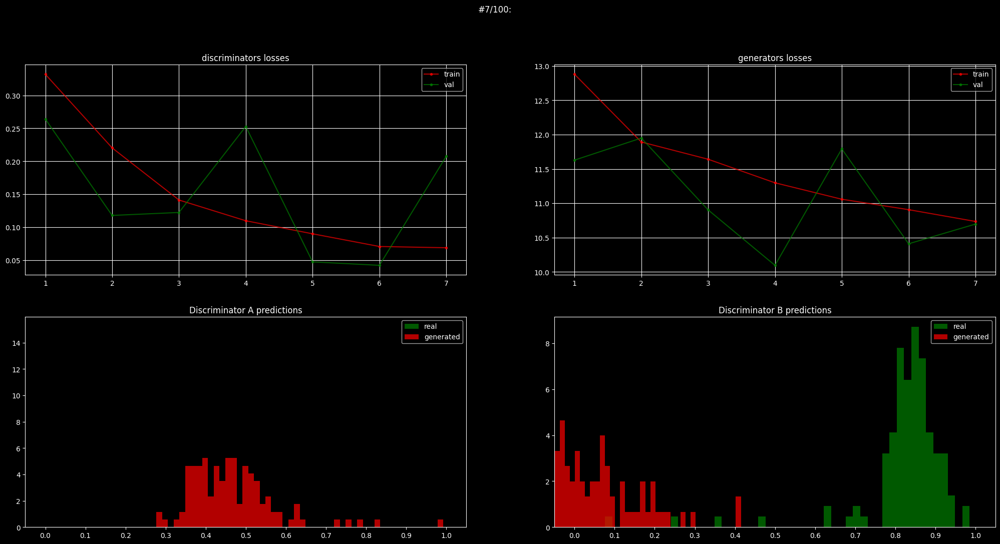

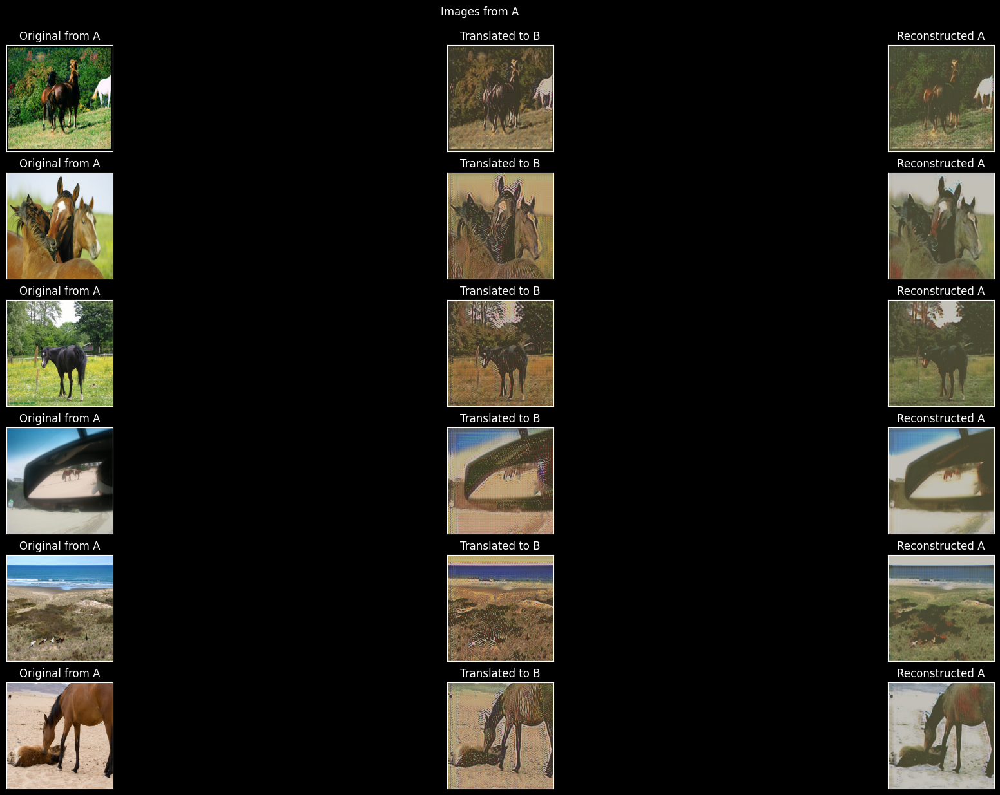

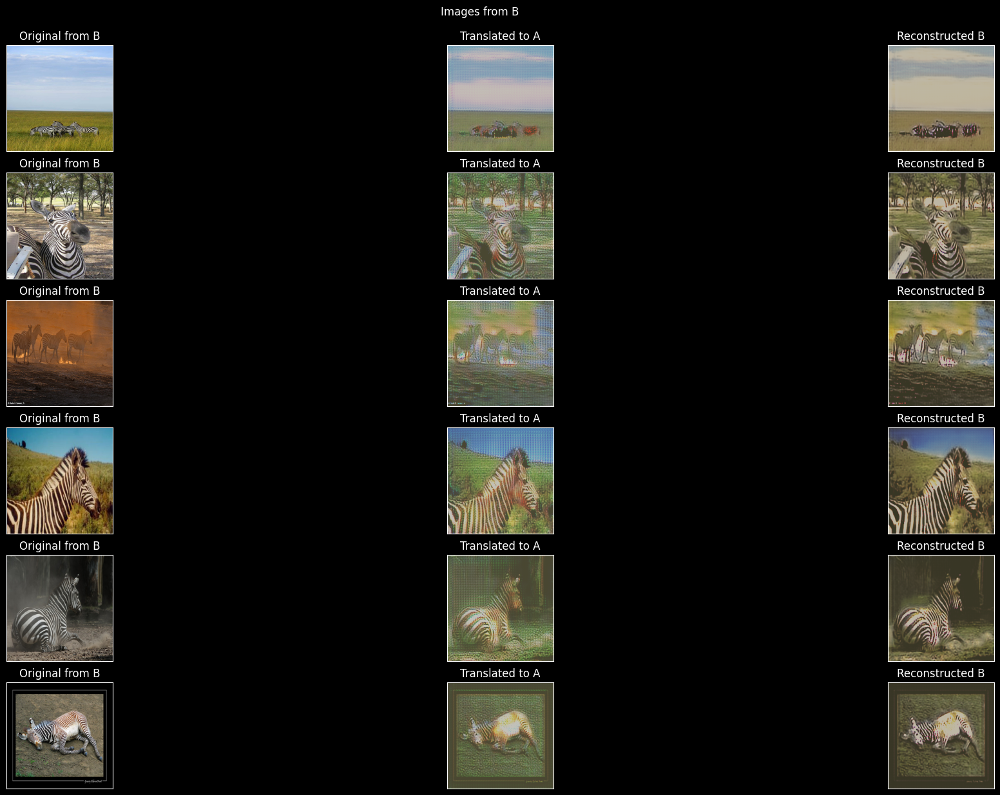

#8/100:


Train G&D:   0%|          | 0/1067 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [62]:
%%time
model, optimizer_d, optimizer_g, plots = learning_loop(
    model = model,
    optimizer_g = optimizer_g,
    g_iters_per_epoch = 1,
    optimizer_d = optimizer_d,
    d_iters_per_epoch = 1,
    train_loader_a = dataloaders.train_a,
    train_loader_b = dataloaders.train_b,
    val_loader_a = dataloaders.test_a,
    val_loader_b = dataloaders.test_b,
    criterion_d = criterion_d,
    criterion_g = criterion_g,
    scheduler_g = scheduler_g,
    scheduler_d = scheduler_d,
    de_norm_a = de_normalize_a,
    de_norm_b = de_normalize_b,
    epochs = 100,
    min_lr = 1e-6,
    val_every = 1,
    draw_every = 1,
    chkp_folder = "./chkp",
    model_name = "cycle_gan",
    images_per_validation=6,
    plots=None,
    starting_epoch=0,
)

In [ ]:
model

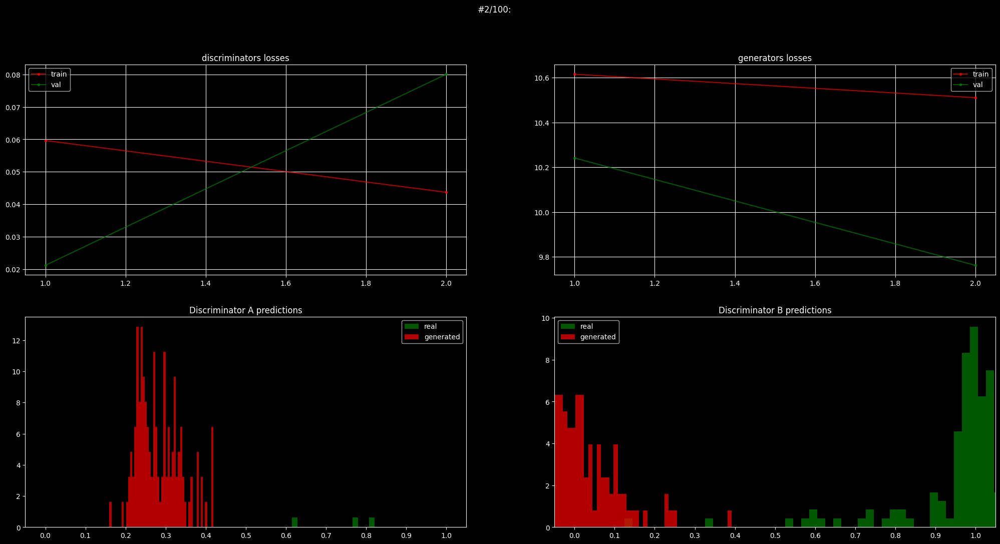

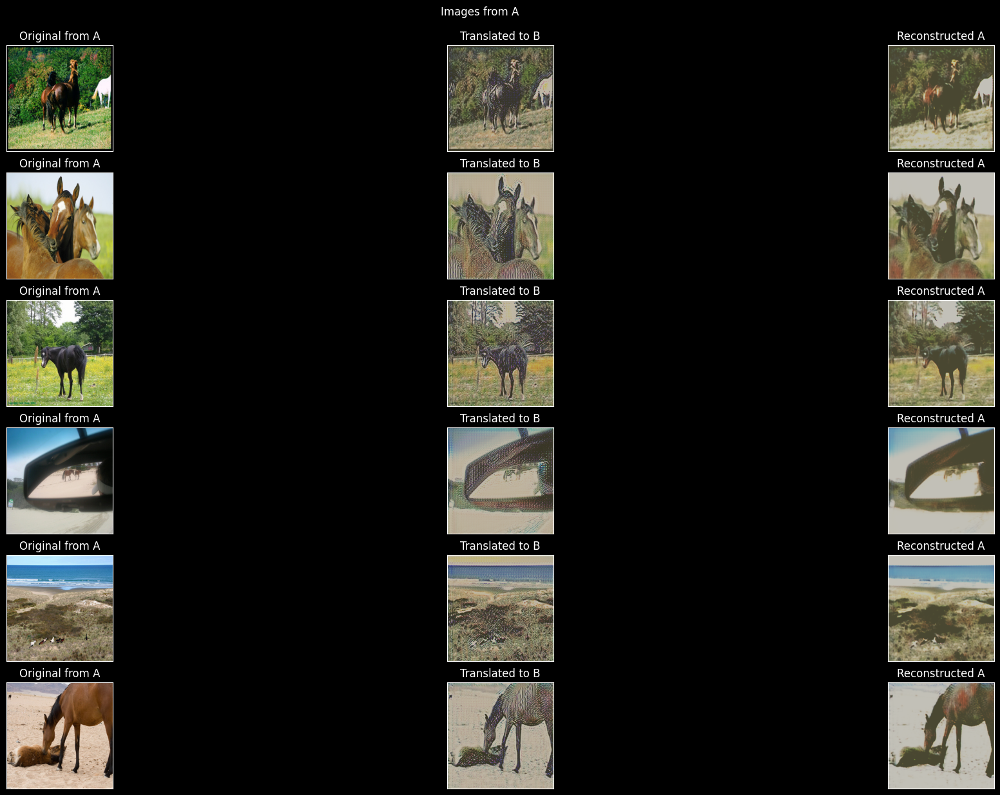

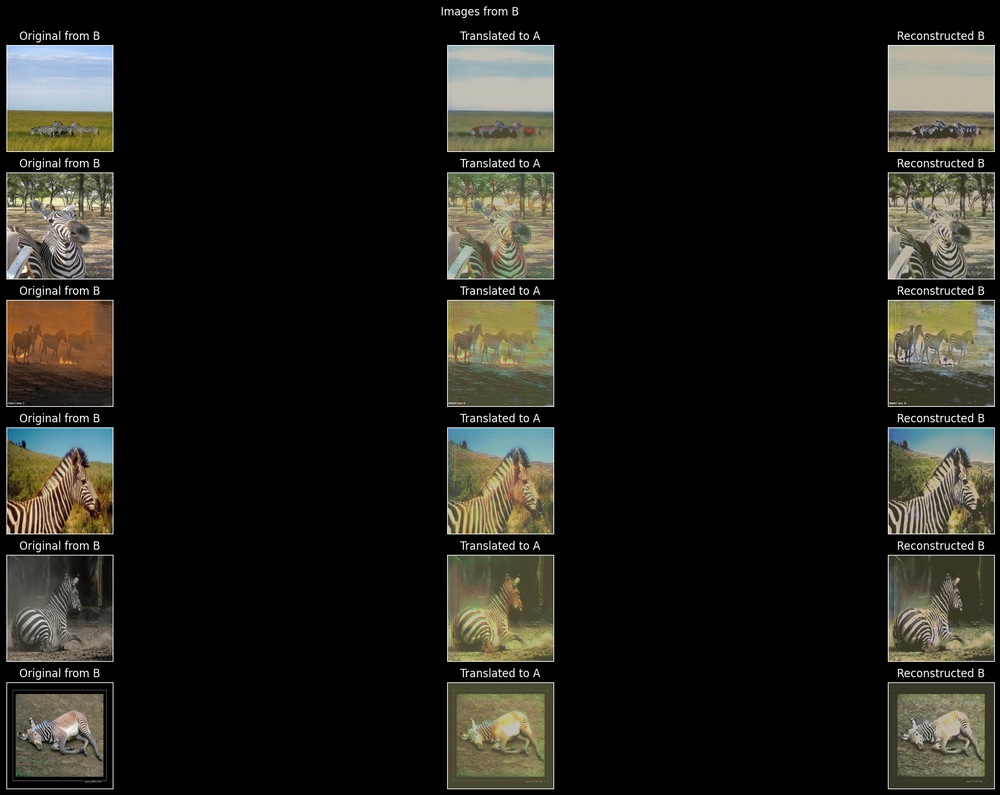

#3/100:


Train G&D:   0%|          | 0/1067 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [63]:
%%time
model, optimizer_d, optimizer_g, plots = learning_loop(
    model = model,
    optimizer_g = optimizer_g,
    g_iters_per_epoch = 1,
    optimizer_d = optimizer_d,
    d_iters_per_epoch = 1,
    train_loader_a = dataloaders.train_a,
    train_loader_b = dataloaders.train_b,
    val_loader_a = dataloaders.test_a,
    val_loader_b = dataloaders.test_b,
    criterion_d = criterion_d,
    criterion_g = criterion_g,
    scheduler_g = scheduler_g,
    scheduler_d = scheduler_d,
    de_norm_a = de_normalize_a,
    de_norm_b = de_normalize_b,
    epochs = 100,
    min_lr = 1e-6,
    val_every = 1,
    draw_every = 1,
    chkp_folder = "./chkp",
    model_name = "cycle_gan",
    images_per_validation=6,
    plots=None,
    starting_epoch=0,
)

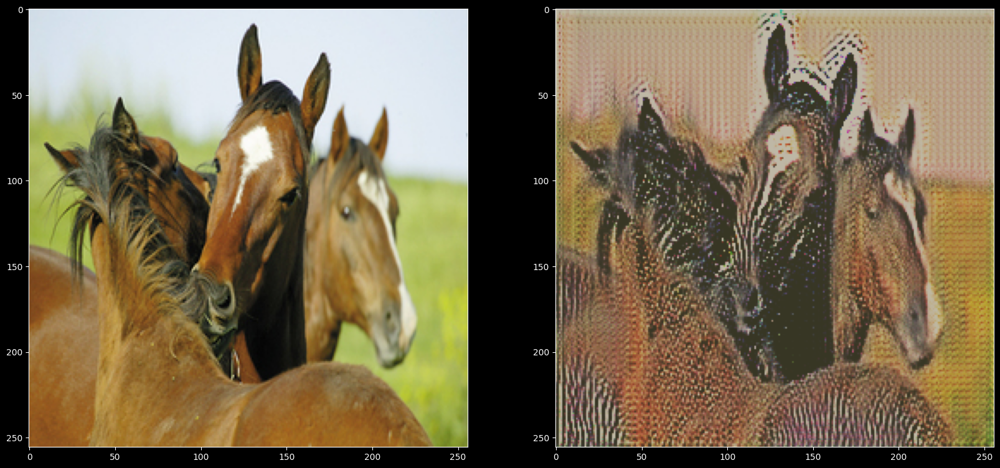

In [83]:
img_a = ds.test_a[1].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
with torch.no_grad():
    fake_b = model.G_AB(img_a)
plt.imshow(de_normalize_b(fake_b[0]))

plt.show()

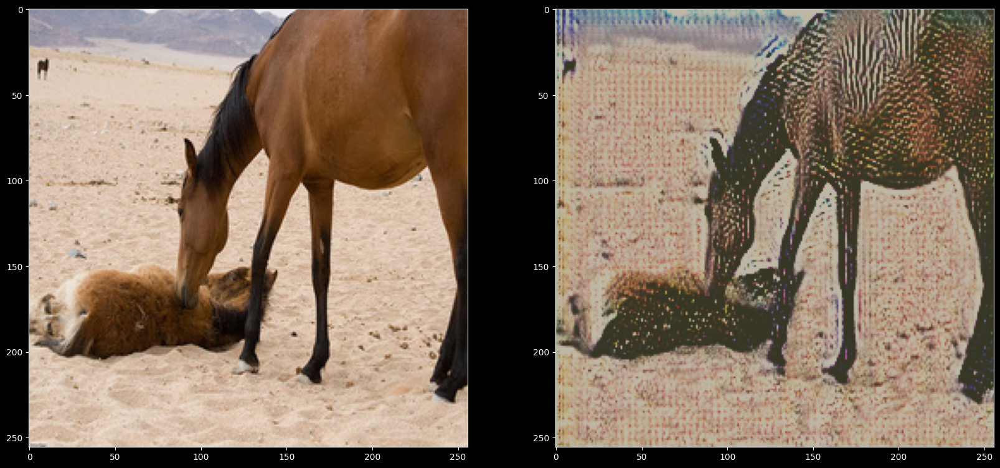

In [84]:
img_a = ds.test_a[5].to(device).unsqueeze(0)

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
with torch.no_grad():
    plt.imshow(de_normalize_b(model.G_AB(img_a)[0]))

plt.show()

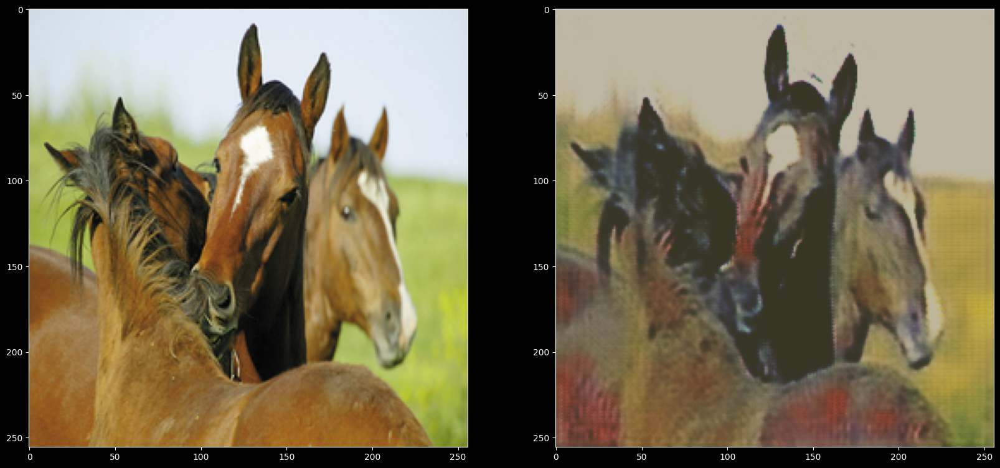

In [87]:
img_ind = 1
img_a = ds.test_a[img_ind].to(device).unsqueeze(0)
with torch.no_grad():
    fake_b = model.G_BA(model.G_AB(img_a))[0]

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_a(img_a[0]))

plt.subplot(122)
plt.imshow(de_normalize_b(fake_b))

plt.show()

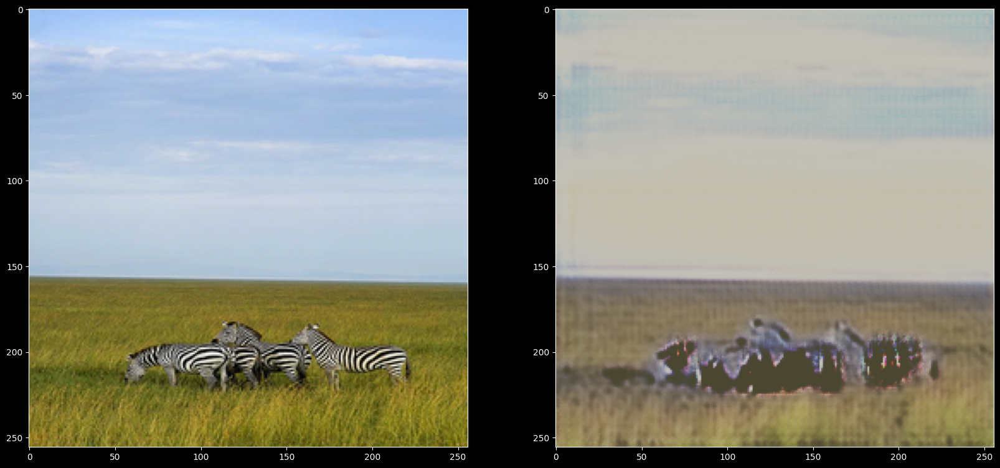

In [89]:
img_ind = 0
img_b = ds.test_b[img_ind].to(device).unsqueeze(0)
with torch.no_grad():
    fake_a = model.G_AB(model.G_BA(img_b))[0]

plt.subplots(1, 2, figsize=(20, 10))

plt.subplot(121)
plt.imshow(de_normalize_b(img_b[0]))

plt.subplot(122)
plt.imshow(de_normalize_a(fake_a))

plt.show()

In [91]:
torch.save(model.G_AB.state_dict(), 'cycle_gan_G_AB.pth')

# 5. Свои данные (___3 балла + бонусы___)

В этой части необходимо выполнить следующее:

1. **Создание датасетов**  
   * Соберите один или пару небольших датасета (минимум 100 примеров, но чем больше, тем лучше).  
   * Дайте волю фантазии, но избегайте неадекватного контента, объема данных или данных за рамками норм.  

2. **Обучение CycleGAN**  
   * Обучите модель CycleGAN для преобразования между вашим датасетом (**домен A**) и другим датасетом (**домен B**).  
   * Второй датасет может быть вашим собственным или любым существующим  

3. **Требования к сдаче**  
   * **Архив с датасетами**:  
     Приложите ссылку на заархивированные данные или загрузите сам архив с данными, использованные для обучения.  
   * **Jupyter Notebook**:  
     * Визуализируйте примеры из доменов A и B с кратким описанием идеи (например, "преобразование эскизов в цветные рисунки").  
     * Добавьте код обучения модели (архитектура, гиперпараметры, функция потерь).  
     * Покажите результаты работы модели (минимум по 5 примеров преобразований A→B и B→A).  
   * **Hugging Face Space + Streamlit**:  
     * Разработайте интерактивное приложение с использованием Streamlit, которое позволяет:  
       - Загружать изображения из доменов A и B.  
       - Отображать результаты преобразований (A→B и B→A) в реальном времени.  
     * Выложите приложение в Hugging Face Space и приложите ссылку на него.  
     * Убедитесь, что модель интегрирована в приложение, а проверяющие могут самостоятельно тестировать её через интерфейс.  

4. **Критерии оценки**  
   * Дополнительные баллы начисляются за:  
     - Креативные и качественные датасеты.  
     - Высокое качество преобразований (четкость, сохранение структуры, отсутствие артефактов).  
     - Удобный и наглядный интерфейс Streamlit-приложения.  

**Примеры идей для датасетов**:  
- Эскизы → Реалистичные изображения.  
- Дневные фото → Ночные фото.  
- Картины в стиле импрессионизма → фотореализм.  

**Важно**:  
- Проверяющий будет оценивать работу через ваше Streamlit-приложение. Убедитесь, что инференс работает стабильно.  
- Если модель слишком велика для деплоя, используйте оптимизацию.  

___Удачи!___ 🚀